In [1]:
# Cell 1: Imports and Configurations

import os
import numpy as np
import nibabel as nib
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, random_split
from tqdm import tqdm
import torchio as tio
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
from collections import defaultdict


# Set seed and device
# torch.manual_seed(42)
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# print(f"✅ Using device: {device}")

import os
# os.environ["CUDA_VISIBLE_DEVICES"] = "0"
device = torch.device("cuda:1" if torch.cuda.is_available() else "cpu")


# Global configs
IMG_SIZE = 128
BATCH_SIZE = 1
NUM_CLASSES = 4


In [2]:
class BraTSDataset(Dataset):
    def __init__(self, root_dir, transform=None, train=True):
        self.root_dir = root_dir
        self.patient_dirs = sorted(os.listdir(root_dir))
        self.transform = transform
        self.train = train

    def __len__(self):
        return len(self.patient_dirs)

    def __getitem__(self, idx):
        patient_id = self.patient_dirs[idx]
        patient_path = os.path.join(self.root_dir, patient_id)

        files = os.listdir(patient_path)
        files_lower = [f.lower() for f in files]

        # Detect dataset style
        if any('flair' in f for f in files_lower):
            modality_map = {
                "flair": next(f for f in files if 'flair' in f.lower()),
                "t1":    next(f for f in files if 't1' in f.lower() and 'ce' not in f.lower()),
                "t1ce":  next(f for f in files if 't1ce' in f.lower()),
                "t2":    next(f for f in files if 't2' in f.lower() and 'w' not in f.lower()),
            }
        elif any('t2w' in f for f in files_lower):
            modality_map = {
                "t1c": next(f for f in files if 't1c' in f.lower()),
                "t1n": next(f for f in files if 't1n' in f.lower()),
                "t2f": next(f for f in files if 't2f' in f.lower()),
                "t2w": next(f for f in files if 't2w' in f.lower()),
            }
        else:
            raise FileNotFoundError(f"Unknown modality pattern for patient {patient_id}")

        # Load modalities
        image_data = []
        for key in modality_map:
            img_path = os.path.join(patient_path, modality_map[key])
            image = nib.load(img_path).get_fdata()
            image_data.append(image)

        image_np = np.stack(image_data, axis=0).astype(np.float32)
        image_tensor = torch.tensor(image_np)

        # Load segmentation
        label_tensor = None
        for f in files:
            if 'seg' in f.lower():
                label_np = nib.load(os.path.join(patient_path, f)).get_fdata().astype(np.uint8)
                label_np[label_np == 4] = 3  # remap BraTS label 4 to 3
                label_tensor = torch.from_numpy(label_np).long().unsqueeze(0)
                break

        if self.train and label_tensor is None:
            raise FileNotFoundError(f"Missing segmentation label for {patient_id}")

        # Transform
        if self.transform:
            subject_dict = {"images": tio.ScalarImage(tensor=image_tensor)}
            if label_tensor is not None:
                subject_dict["label"] = tio.LabelMap(tensor=label_tensor)
            subject = tio.Subject(**subject_dict)
            transformed = self.transform(subject)
            image_tensor = transformed["images"].data
            if label_tensor is not None:
                label_tensor = transformed["label"].data

        return (image_tensor, label_tensor, patient_id) if label_tensor is not None else (image_tensor, None, patient_id)


In [3]:
# Cell 3: Preprocessing Transforms

preprocess = tio.Compose([
    tio.RescaleIntensity(out_min_max=(0, 1)),
    tio.Resize((128, 128, 128)),
    tio.ZNormalization()
])

augment = tio.Compose([
    tio.RandomBiasField(p=0.3),
    tio.RandomGamma(p=0.3),
    tio.RandomNoise(p=0.2),
    tio.RandomFlip(axes=('LR',), p=0.5),
    tio.RandomAffine(scales=(0.9, 1.1), degrees=10, translation=5, p=0.5),
    preprocess
])


In [4]:
# Cell 4: Hospital Loader Setup

# Hospital1_Train = 'Data/2023GLI/TrainingData'
# Hospital1_Val   = 'Data/2023GLI/ValidationData'
# Hospital2_Train = 'Data/2023MEN/TrainingData'
# Hospital2_Val   = 'Data/2023MEN/ValidationData'
# Hospital3_Train = 'Data/2023MET/TrainingData'
# Hospital3_Val   = 'Data/2023MET/ValidationData'
# Hospital4_Train = 'Data/2023PED/TrainingData'
# Hospital4_Val   = 'Data/2023PED/ValidationData'
# Hospital5_Train = 'Data/2023SSA/TrainingData'
# Hospital5_Val   = 'Data/2023SSA/ValidationData'
# Hospital6_Train_Val = 'Data/BraTS2021'
# Hospital7_Train = 'Data/BraTS2020/TrainingData'
# Hospital7_Val   = 'Data/BraTS2020/ValidationData'
# Hospital8_Train_Val = 'Data/BraTS2019/HGG'
# Hospital9_Train_Val = 'Data/BraTS2019/LGG'



hospital_paths = {
    "Hospital1": "Data/2023GLI/TrainingData",
    "Hospital2": "Data/BraTS2019/HGG",
    "Hospital3": "Data/BraTS2020/TrainingData",
    "Hospital4": "Data/BraTS2021",
    "Hospital5": "Data/2023SSA/TrainingData",
    "Hospital6": "Data/2023MEN/TrainingData",
    "Hospital7": "Data/2023MET/TrainingData",
    "Hospital8": "Data/2023PED/TrainingData",
    "Hospital9": "Data/BraTS2019/LGG",
}

hospital_loaders = {}
for name, path in hospital_paths.items():
    dataset = BraTSDataset(path, transform=preprocess)
    train_size = int(0.8 * len(dataset))
    val_size = len(dataset) - train_size
    train_set, val_set = random_split(dataset, [train_size, val_size])

    hospital_loaders[name] = {
        "train": DataLoader(train_set, batch_size=BATCH_SIZE, shuffle=True),
        "val": DataLoader(val_set, batch_size=1, shuffle=False)
    }

print("✅ Hospital loaders ready.")


✅ Hospital loaders ready.


In [5]:
# Cell 5: TumorVisNet3D Architecture

class ConvBlock3D(nn.Module):
    def __init__(self, in_channels, out_channels, dropout=False, p=0.2):
        super().__init__()
        layers = [
            nn.Conv3d(in_channels, out_channels, 3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, 3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        ]
        if dropout:
            layers.append(nn.Dropout3d(p))
        self.block = nn.Sequential(*layers)

    def forward(self, x):
        return self.block(x)

class ViTBottleneck3D(nn.Module):
    def __init__(self, input_dim, embed_dim=256, num_heads=4, ff_dim=512, dropout=0.1):
        super().__init__()
        self.proj = nn.Conv3d(input_dim, embed_dim, kernel_size=1)
        self.reproj = nn.Conv3d(embed_dim, input_dim, kernel_size=1)
        encoder_layer = nn.TransformerEncoderLayer(d_model=embed_dim, nhead=num_heads,
                                                   dim_feedforward=ff_dim, dropout=dropout, batch_first=True)
        self.transformer = nn.TransformerEncoder(encoder_layer, num_layers=1)

    def forward(self, x):
        B, C, D, H, W = x.shape
        x = self.proj(x)                       # [B, embed_dim, D, H, W]
        x = x.flatten(2).permute(0, 2, 1)      # [B, N, embed_dim]
        x = self.transformer(x)
        x = x.permute(0, 2, 1).view(B, -1, D, H, W)
        return self.reproj(x)

class UpBlock3D(nn.Module):
    def __init__(self, in_channels, skip_channels, out_channels):
        super().__init__()
        self.up = nn.ConvTranspose3d(in_channels, out_channels, kernel_size=2, stride=2)
        self.conv = ConvBlock3D(out_channels + skip_channels, out_channels)

    def forward(self, x, skip):
        x = self.up(x)
        if x.shape[2:] != skip.shape[2:]:
            skip = F.interpolate(skip, size=x.shape[2:], mode='trilinear', align_corners=False)
        x = torch.cat([x, skip], dim=1)
        return self.conv(x)

class TumorVisNet3D(nn.Module):
    def __init__(self, in_channels=4, num_classes=4):
        super().__init__()
        self.enc1 = ConvBlock3D(in_channels, 32)
        self.pool1 = nn.MaxPool3d(2)
        self.enc2 = ConvBlock3D(32, 64)
        self.pool2 = nn.MaxPool3d(2)
        self.enc3 = ConvBlock3D(64, 128)
        self.pool3 = nn.MaxPool3d(2)
        self.enc4 = ConvBlock3D(128, 256)
        self.pool4 = nn.MaxPool3d(2)
        self.center = ConvBlock3D(256, 512, dropout=True)
        self.vit = ViTBottleneck3D(512)
        self.up4 = UpBlock3D(512, 256, 256)
        self.up3 = UpBlock3D(256, 128, 128)
        self.up2 = UpBlock3D(128, 64, 64)
        self.up1 = UpBlock3D(64, 32, 32)
        self.final = nn.Conv3d(32, num_classes, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool1(e1))
        e3 = self.enc3(self.pool2(e2))
        e4 = self.enc4(self.pool3(e3))
        c = self.center(self.pool4(e4))
        b = self.vit(c)
        d4 = self.up4(b, e4)
        d3 = self.up3(d4, e3)
        d2 = self.up2(d3, e2)
        d1 = self.up1(d2, e1)
        return self.final(d1)


In [7]:
# Cell 6: Dice Loss and Evaluation

def dice_loss(pred, target, epsilon=1e-6):
    pred = torch.softmax(pred, dim=1)
    if target.shape[2:] != pred.shape[2:]:
        target = F.interpolate(target.float(), size=pred.shape[2:], mode='nearest')

    target = target.squeeze(1).long()
    target_onehot = F.one_hot(target, num_classes=pred.shape[1])
    target_onehot = target_onehot.permute(0, 4, 1, 2, 3).float()

    intersection = (pred * target_onehot).sum(dim=(2, 3, 4))
    union = pred.sum(dim=(2, 3, 4)) + target_onehot.sum(dim=(2, 3, 4))
    dice = (2 * intersection + epsilon) / (union + epsilon)
    return 1 - dice.mean()

def evaluate_model(model, dataloader, device="cuda:1"):
    model.eval()
    dices = []
    with torch.no_grad():
        for batch in dataloader:
            if len(batch) == 3:
                images, masks, _ = batch
            else:
                images, masks = batch

            images = images.to(device)
            masks = masks.to(device)

            outputs = model(images)
            preds = torch.argmax(outputs, dim=1)

            if masks.shape[2:] != preds.shape[1:]:
                masks = F.interpolate(masks.float(), size=preds.shape[1:], mode='nearest').long()

            masks = masks.squeeze(1)
            preds = preds.squeeze(1)

            intersection = ((preds == masks) & (masks > 0)).float().sum()
            union = ((preds > 0).float() + (masks > 0).float()).sum()

            dice_score = (2. * intersection + 1e-6) / (union + 1e-6)
            dices.append(dice_score.item())

    if len(dices) == 0:
        print("⚠️ No valid batches evaluated.")
        return 0.0

    return np.mean(dices)



In [8]:
from collections import defaultdict
from torch.cuda.amp import autocast, GradScaler
import torch.nn.functional as F

def compute_all_metrics(pred, target, num_classes=4, epsilon=1e-6):
    pred_softmax = torch.softmax(pred, dim=1)
    pred_labels = torch.argmax(pred_softmax, dim=1)

    if target.shape[2:] != pred_labels.shape[1:]:
        target = F.interpolate(target.float(), size=pred_labels.shape[1:], mode='nearest').long()

    target = target.squeeze(1)
    pred_labels = pred_labels.squeeze(1)

    total_metrics = {'accuracy': 0, 'dice': 0, 'iou': 0, 'precision': 0, 'sensitivity': 0, 'specificity': 0}
    for cls in range(1, num_classes):
        pred_bin = (pred_labels == cls).float()
        target_bin = (target == cls).float()

        TP = (pred_bin * target_bin).sum()
        FP = (pred_bin * (1 - target_bin)).sum()
        FN = ((1 - pred_bin) * target_bin).sum()
        TN = ((1 - pred_bin) * (1 - target_bin)).sum()

        precision = TP / (TP + FP + epsilon)
        sensitivity = TP / (TP + FN + epsilon)
        specificity = TN / (TN + FP + epsilon)
        dice = (2 * TP + epsilon) / (2 * TP + FP + FN + epsilon)
        iou = TP / (TP + FP + FN + epsilon)

        total_metrics['accuracy'] += ((pred_labels == target).float().mean()).item()
        total_metrics['precision'] += precision.item()
        total_metrics['sensitivity'] += sensitivity.item()
        total_metrics['specificity'] += specificity.item()
        total_metrics['dice'] += dice.item()
        total_metrics['iou'] += iou.item()

    for k in total_metrics:
        total_metrics[k] /= (num_classes - 1)

    return total_metrics

def train_one_client_verbose(model, dataloader, optimizer, epochs=1, client_name="", device="cuda:1"):
    model.train()
    model.to(device)
    scaler = GradScaler()

    for epoch in range(epochs):
        running_loss = 0
        running_metrics = defaultdict(list)
        print(f"\n🔁 Training {client_name} | Epoch {epoch+1}/{epochs}")

        for batch_idx, batch in enumerate(dataloader):
            if len(batch) == 3:
                images, masks, ids = batch
            else:
                images, masks = batch
                ids = ["Unknown"]

            images, masks = images.to(device), masks.to(device)
            optimizer.zero_grad()

            with autocast():
                outputs = model(images)
                loss = dice_loss(outputs, masks)

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            metrics = compute_all_metrics(outputs, masks)
            for k, v in metrics.items():
                running_metrics[k].append(v)

            running_loss += loss.item()

            print(f"🩺 Case: {ids[0]} | Batch {batch_idx+1}/{len(dataloader)} | "
                  f"Loss: {loss.item():.4f} | Dice: {metrics['dice']:.4f} | "
                  f"Acc: {metrics['accuracy']:.4f} | IoU: {metrics['iou']:.4f} | "
                  f"Prec: {metrics['precision']:.4f} | Sen: {metrics['sensitivity']:.4f} | "
                  f"Spec: {metrics['specificity']:.4f}")

        avg_loss = running_loss / len(dataloader)
        print(f"\n📊 Epoch {epoch+1} Summary for {client_name}")
        print(f"Avg Loss: {avg_loss:.4f}")
        for k in running_metrics:
            print(f"Avg {k.capitalize()}: {np.mean(running_metrics[k]):.4f}")

    return model.state_dict()


In [10]:
from torch.optim import Adam

NUM_EPOCHS = 5  # Change to 10+ for full runs
LR = 1e-4

trained_models = {}
hospital_metrics = {}

for hospital, loaders in hospital_loaders.items():
    print(f"\n=== 🏥 Training on {hospital} ===")

    model = TumorVisNet3D(in_channels=4, num_classes=NUM_CLASSES).to(device)
    optimizer = Adam(model.parameters(), lr=LR)

    # Train the model
    state_dict = train_one_client_verbose(
        model, loaders["train"], optimizer,
        epochs=NUM_EPOCHS,
        client_name=hospital,
        device=device
    )

    # Save model state
    trained_models[hospital] = state_dict

    # Load best weights and evaluate
    model.load_state_dict(state_dict)
    val_metrics = []

    with torch.no_grad():
        for batch in loaders["val"]:
            if len(batch) == 3:
                images, masks, _ = batch
            else:
                images, masks = batch

            images = images.to(device)
            masks = masks.to(device)

            outputs = model(images)
            metrics = compute_all_metrics(outputs, masks)
            val_metrics.append(metrics)

    # Aggregate results
    avg_metrics = {
        k: np.mean([m[k] for m in val_metrics])
        for k in val_metrics[0]
    }

    hospital_metrics[hospital] = avg_metrics
    print(f"\n📈 Final Evaluation for {hospital}:")
    for k, v in avg_metrics.items():
        print(f"{k.capitalize()}: {v:.4f}")



=== 🏥 Training on Hospital1 ===

🔁 Training Hospital1 | Epoch 1/5


/tmp/ipykernel_249855/1997850118.py:46: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_249855/1997850118.py:63: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


🩺 Case: BraTS-GLI-00772-000 | Batch 1/1000 | Loss: 0.8951 | Dice: 0.0019 | Acc: 0.1432 | IoU: 0.0010 | Prec: 0.0010 | Sen: 0.1482 | Spec: 0.7145
🩺 Case: BraTS-GLI-01157-000 | Batch 2/1000 | Loss: 0.8890 | Dice: 0.0050 | Acc: 0.1633 | IoU: 0.0025 | Prec: 0.0028 | Sen: 0.0916 | Spec: 0.7233
🩺 Case: BraTS-GLI-00747-000 | Batch 3/1000 | Loss: 0.8875 | Dice: 0.0038 | Acc: 0.2617 | IoU: 0.0019 | Prec: 0.0021 | Sen: 0.1362 | Spec: 0.7547
🩺 Case: BraTS-GLI-01162-000 | Batch 4/1000 | Loss: 0.8926 | Dice: 0.0026 | Acc: 0.1422 | IoU: 0.0013 | Prec: 0.0013 | Sen: 0.1635 | Spec: 0.7160
🩺 Case: BraTS-GLI-01086-000 | Batch 5/1000 | Loss: 0.8851 | Dice: 0.0010 | Acc: 0.3375 | IoU: 0.0005 | Prec: 0.0008 | Sen: 0.0804 | Spec: 0.7811
🩺 Case: BraTS-GLI-01237-000 | Batch 6/1000 | Loss: 0.8852 | Dice: 0.0161 | Acc: 0.3117 | IoU: 0.0082 | Prec: 0.0098 | Sen: 0.2645 | Spec: 0.7708
🩺 Case: BraTS-GLI-00646-000 | Batch 7/1000 | Loss: 0.8787 | Dice: 0.0290 | Acc: 0.4422 | IoU: 0.0149 | Prec: 0.0222 | Sen: 0.2140 

In [9]:
# Cell 7: Local Training Function and FedAvg

from torch.cuda.amp import autocast, GradScaler

scaler = GradScaler()

def train_one_client(model, dataloader, optimizer, epochs=1, client_name="", device="cuda:1"):
    model.train()
    model.to(device)
    total_loss = 0

    for epoch in range(epochs):
        epoch_loss = 0
        print(f"🚀 [{client_name}] Epoch {epoch+1}/{epochs}")
        for i, (images, masks) in enumerate(dataloader):
            images = images.to(device)
            masks = masks.to(device)

            optimizer.zero_grad()
            with autocast():
                outputs = model(images)
                loss = dice_loss(outputs, masks)

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            epoch_loss += loss.item()
        print(f"✅ [{client_name}] Epoch {epoch+1} Loss: {epoch_loss/len(dataloader):.4f}")
        total_loss += epoch_loss

    return model.state_dict()

def fed_avg(client_weights):
    new_state_dict = {}
    for k in client_weights[0].keys():
        new_state_dict[k] = torch.stack([cw[k].float() for cw in client_weights], dim=0).mean(dim=0)
    return new_state_dict


/tmp/ipykernel_3531697/3654935721.py:5: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


In [10]:
def federated_training_rounds(
    client_names,
    hospital_loaders,
    base_model_fn,
    num_rounds=5,
    local_epochs=1,
    lr=1e-4,
    device="cuda:1"
):
    global_model = base_model_fn().to(device)
    global_weights = global_model.state_dict()

    history = {
        "round": [],
        "global_val_dice": [],
        "client_val_dice": {client: [] for client in client_names}
    }

    for rnd in range(1, num_rounds + 1):
        print(f"\n🌍 Federated Round {rnd}/{num_rounds}")
        client_weights = []

        for client in client_names:
            print(f"\n🔹 Client: {client}")
            model = base_model_fn().to(device)
            model.load_state_dict(global_weights)

            optimizer = torch.optim.Adam(model.parameters(), lr=lr)
            train_loader = hospital_loaders[client]["train"]

            client_state = train_one_client_verbose(
                model, train_loader, optimizer,
                epochs=local_epochs,
                client_name=client,
                device=device
            )
            client_weights.append(client_state)

        # Average weights and update global model
        global_weights = fed_avg(client_weights)
        global_model.load_state_dict(global_weights)

        # Validation
        dice_scores = []
        for client in client_names:
            val_loader = hospital_loaders[client]["val"]
            dice = evaluate_model(global_model.to(device), val_loader, device=device)
            dice_scores.append(dice)
            history["client_val_dice"][client].append(dice)
            print(f"📈 {client} Validation Dice: {dice:.4f}")

        avg_dice = np.mean(dice_scores)
        history["round"].append(rnd)
        history["global_val_dice"].append(avg_dice)
        print(f"\n✅ Round {rnd} Summary: Global Average Dice = {avg_dice:.4f}")

    return global_model, history


In [11]:
import pandas as pd
import matplotlib.pyplot as plt

def summarize_training_history(history):
    df_rounds = pd.DataFrame({
        "Round": history["round"],
        "Global_Avg_Dice": history["global_val_dice"]
    })
    for client, scores in history["client_val_dice"].items():
        df_rounds[client] = scores
    return df_rounds

def save_training_history_to_csv(history, filename="training_history.csv"):
    df = summarize_training_history(history)
    df.to_csv(filename, index=False)
    print(f"📄 Training history saved to {filename}")

def plot_prediction_overlay(image, gt_mask, pred_mask, slice_idx=64, client_name="Client"):
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    axs[0].imshow(image[0, 3, :, :, slice_idx].cpu(), cmap='gray')
    axs[0].set_title(f"{client_name} - Input (FLAIR)")
    axs[1].imshow(gt_mask[0, 0, :, :, slice_idx].cpu(), cmap='Blues')
    axs[1].set_title("Ground Truth")
    axs[2].imshow(pred_mask[:, :, slice_idx].cpu(), cmap='Reds')
    axs[2].set_title("Predicted")
    plt.tight_layout()
    plt.show()

def test_global_with_overlays(global_model, hospital_loaders, client_names, device="cuda:1"):
    global_model.eval()
    results = {}
    with torch.no_grad():
        for client in client_names:
            val_loader = hospital_loaders[client]["val"]
            dice_score = evaluate_model(global_model.to(device), val_loader, device=device)
            results[client] = dice_score
            print(f"🧪 Final Dice Score on {client}: {dice_score:.4f}")
            image, label, _ = next(iter(val_loader))
            image, label = image.to(device), label.to(device)
            output = global_model(image)
            pred = torch.argmax(output, dim=1).squeeze(0).cpu()
            plot_prediction_overlay(image.cpu(), label.cpu(), pred, client_name=client)
    return results


In [12]:
import gc
import torch

def clear_cuda():
    gc.collect()
    torch.cuda.empty_cache()
    torch.cuda.ipc_collect()
    print(f"🧹 GPU memory cleared. Available: {torch.cuda.memory_reserved() / 1024**2:.2f} MB")


In [13]:
!nvidia-smi
!fuser -v /dev/nvidia0  # see PIDs using the GPU


Sat May 17 16:37:27 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.144.03             Driver Version: 550.144.03     CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3080        On  |   00000000:21:00.0 Off |                  N/A |
|  0%   48C    P8             21W /  320W |     109MiB /  10240MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [14]:
!kill -9 <3013>


/bin/bash: -c: line 1: syntax error near unexpected token `3013'
/bin/bash: -c: line 1: `kill -9 <3013>'


In [15]:
import torch
torch.cuda.empty_cache()
torch.cuda.ipc_collect()


In [16]:
def build_model():
    return TumorVisNet3D(in_channels=4, num_classes=4)

client_list = list(hospital_loaders.keys())

global_model, training_history = federated_training_rounds(
    client_names=client_list,
    hospital_loaders=hospital_loaders,
    base_model_fn=build_model,
    num_rounds=10,         # You can increase to 10–20 later
    local_epochs=3,       # You can tune this to 3–5
    lr=1e-4,
    device=device
)



🌍 Federated Round 1/10

🔹 Client: Hospital1


/tmp/ipykernel_3531697/1997850118.py:46: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)



🔁 Training Hospital1 | Epoch 1/3


/tmp/ipykernel_3531697/1997850118.py:63: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


🩺 Case: BraTS-GLI-00132-000 | Batch 1/1000 | Loss: 0.8836 | Dice: 0.0159 | Acc: 0.7647 | IoU: 0.0081 | Prec: 0.0084 | Sen: 0.1821 | Spec: 0.9233
🩺 Case: BraTS-GLI-01079-000 | Batch 2/1000 | Loss: 0.8727 | Dice: 0.0546 | Acc: 0.7960 | IoU: 0.0291 | Prec: 0.0305 | Sen: 0.2583 | Spec: 0.9335
🩺 Case: BraTS-GLI-00148-000 | Batch 3/1000 | Loss: 0.8790 | Dice: 0.0329 | Acc: 0.8009 | IoU: 0.0169 | Prec: 0.0181 | Sen: 0.3467 | Spec: 0.9336
🩺 Case: BraTS-GLI-00554-000 | Batch 4/1000 | Loss: 0.8692 | Dice: 0.0583 | Acc: 0.8263 | IoU: 0.0317 | Prec: 0.0320 | Sen: 0.3262 | Spec: 0.9419
🩺 Case: BraTS-GLI-01086-000 | Batch 5/1000 | Loss: 0.8676 | Dice: 0.0506 | Acc: 0.8296 | IoU: 0.0266 | Prec: 0.0269 | Sen: 0.4398 | Spec: 0.9430
🩺 Case: BraTS-GLI-00715-001 | Batch 6/1000 | Loss: 0.8699 | Dice: 0.0741 | Acc: 0.8653 | IoU: 0.0393 | Prec: 0.0418 | Sen: 0.4689 | Spec: 0.9550
🩺 Case: BraTS-GLI-01135-000 | Batch 7/1000 | Loss: 0.8637 | Dice: 0.0552 | Acc: 0.8629 | IoU: 0.0291 | Prec: 0.0308 | Sen: 0.3631 

In [17]:
# Cell 9: Final Testing and Prediction Visualization
class_names = ["Background", "Tumor Core", "Edema", "Enhancing Tumor"]

def predict_and_overlay(model, loader, slice_idx=64, client_name="Client"):
    model.eval()
    image, label, _ = next(iter(loader))
    image = image.to(device)
    label = label.to(device)
    with torch.no_grad():
        output = model(image)
    pred = torch.argmax(output, dim=1).squeeze().cpu().numpy()
    true = label.squeeze().cpu().numpy()

    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    axs[0].imshow(image[0, 3, :, :, slice_idx].cpu(), cmap='gray')
    axs[0].set_title(f"{client_name} - Input (FLAIR)")

    axs[1].imshow(true[:, :, slice_idx], cmap='Blues')  # ✅ Fixed
    axs[1].set_title("Ground Truth")

    axs[2].imshow(pred[:, :, slice_idx], cmap='Reds')
    axs[2].set_title("Predicted")

    plt.tight_layout()
    plt.show()


def global_test(global_model, hospital_loaders, client_names):
    results = {}
    for client in client_names:
        val_loader = hospital_loaders[client]["val"]
        dice = evaluate_model(global_model.to(device), val_loader, device=device)
        results[client] = dice
        print(f"🏥 Final Dice on {client}: {dice:.4f}")
        predict_and_overlay(global_model, val_loader, client_name=client)
    return results


import numpy as np
from sklearn.metrics import confusion_matrix

def compute_metrics_for_eval(preds, labels, num_classes=4):
    """
    Compute confusion matrix, IoU, and Dice scores for multi-class predictions.
    
    Args:
        preds (Tensor): Predicted labels (N, D, H, W)
        labels (Tensor): Ground truth labels (N, D, H, W)
        num_classes (int): Number of segmentation classes

    Returns:
        dict: {
            "confusion_matrix": ndarray,
            "iou": list of floats,
            "dice": list of floats
        }
    """
    preds = preds.flatten()
    labels = labels.flatten()

    cm = confusion_matrix(labels.cpu().numpy(), preds.cpu().numpy(), labels=list(range(num_classes)))
    intersection = np.diag(cm)
    gt_total = cm.sum(axis=1)
    pred_total = cm.sum(axis=0)
    union = gt_total + pred_total - intersection

    iou = (intersection / (union + 1e-6)).tolist()
    dice = ((2 * intersection) / (gt_total + pred_total + 1e-6)).tolist()

    return {
        "confusion_matrix": cm,
        "iou": iou,
        "dice": dice
    }


# def predict_and_evaluate(model, loader, device="cuda:1", num_classes=4):
#     model.eval()
#     all_preds = []
#     all_labels = []

#     with torch.no_grad():
#         for batch in loader:
#             if len(batch) == 3:
#                 images, labels, _ = batch
#             else:
#                 images, labels = batch
#             images, labels = images.to(device), labels.to(device)
#             outputs = model(images)
#             preds = torch.argmax(outputs, dim=1)

#             all_preds.append(preds.cpu())
#             all_labels.append(labels.squeeze(1).cpu())

#     all_preds = torch.cat(all_preds, dim=0)
#     all_labels = torch.cat(all_labels, dim=0)

#     return compute_metrics_for_eval(all_preds, all_labels, num_classes=num_classes)


def predict_and_evaluate(model, loader, device="cuda:1", num_classes=4, slice_idx=64):
    model.to(device)
    model.eval()
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for batch in loader:
            if len(batch) == 3:
                images, labels, _ = batch
            else:
                images, labels = batch

            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            preds = torch.argmax(outputs, dim=1)

            # Only take a single axial slice
            pred_slice = preds[0, :, :, slice_idx].cpu().flatten()
            label_slice = labels[0, 0, :, :, slice_idx].cpu().flatten()

            all_preds.append(pred_slice)
            all_labels.append(label_slice)

    all_preds = torch.cat(all_preds)
    all_labels = torch.cat(all_labels)

    return compute_metrics_for_eval(all_preds, all_labels, num_classes=num_classes)


import seaborn as sns
import matplotlib.pyplot as plt

def plot_confusion_matrix(cm, class_names, normalize=False, title="Confusion Matrix"):
    if normalize:
        cm = cm.astype("float") / cm.sum(axis=1)[:, np.newaxis]

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt=".2f" if normalize else "d",
                cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.ylabel("True Label")
    plt.xlabel("Predicted Label")
    plt.title(title)
    plt.tight_layout()
    plt.show()


# Show final metrics
# metrics = predict_and_evaluate(global_model, hospital_loaders["Hospital3"]["val"])
# print(metrics["dice"])
# plot_confusion_matrix(metrics["confusion_matrix"], class_names)


# # Visual inspection
# predict_and_overlay(global_model, hospital_loaders["Hospital3"]["val"], client_name="Hospital3")





🔍 Evaluating Hospital1...


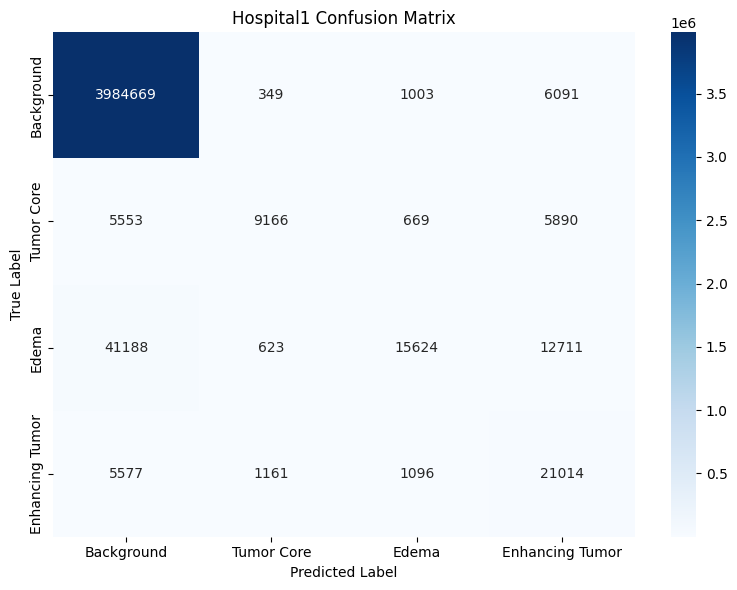

/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


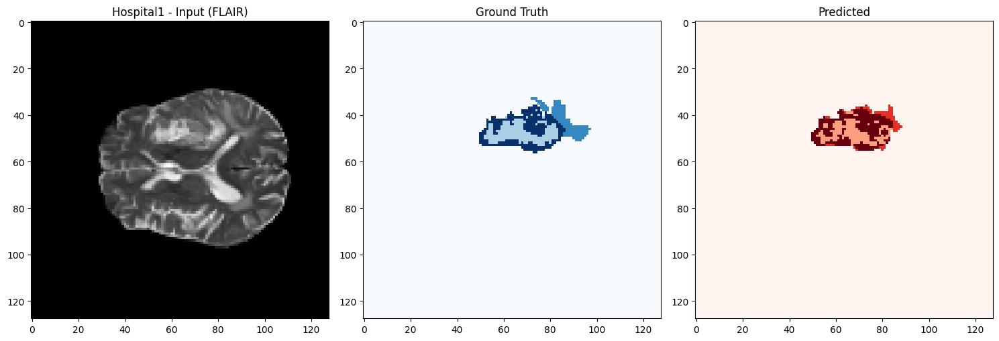


🔍 Evaluating Hospital2...


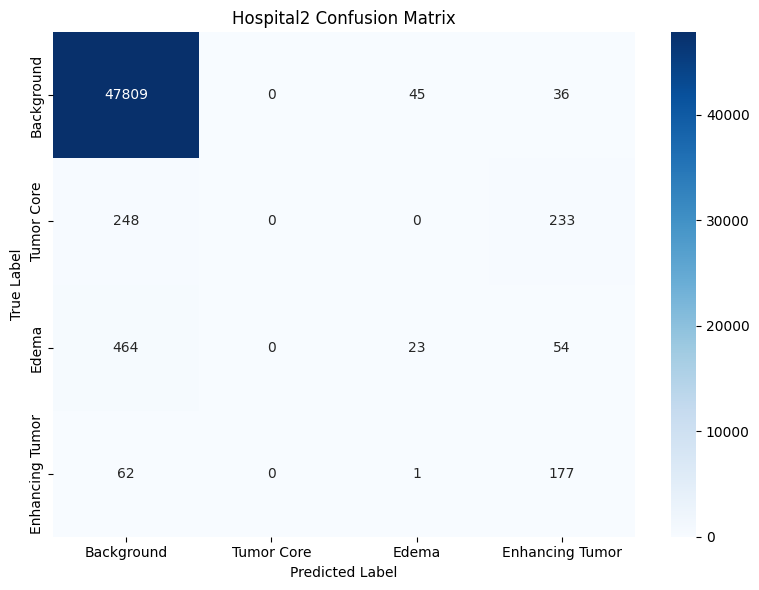

/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


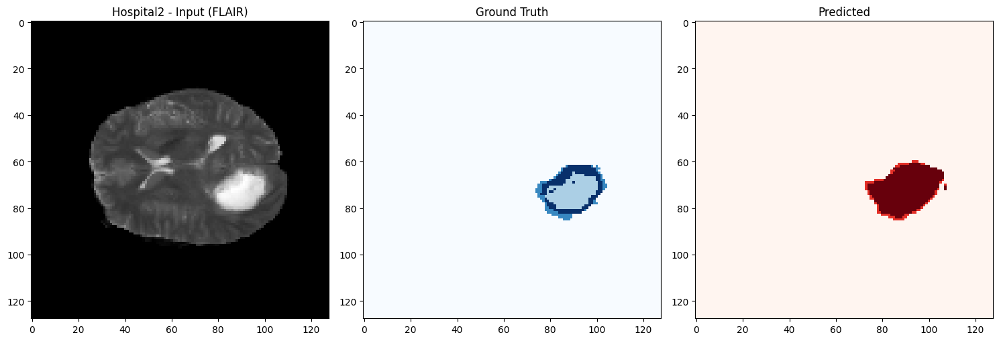


🔍 Evaluating Hospital3...


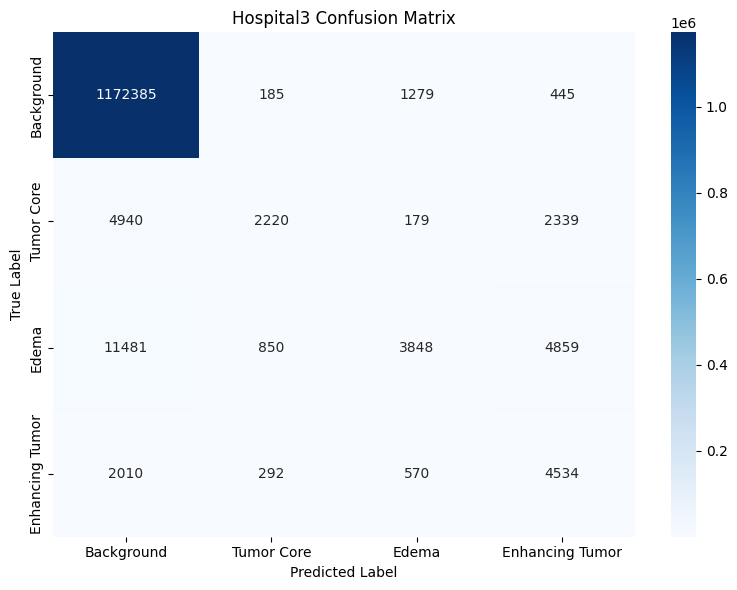

/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


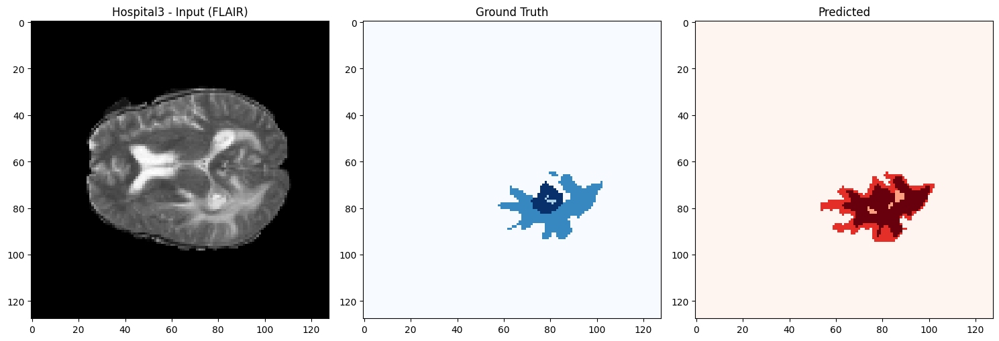


🔍 Evaluating Hospital4...


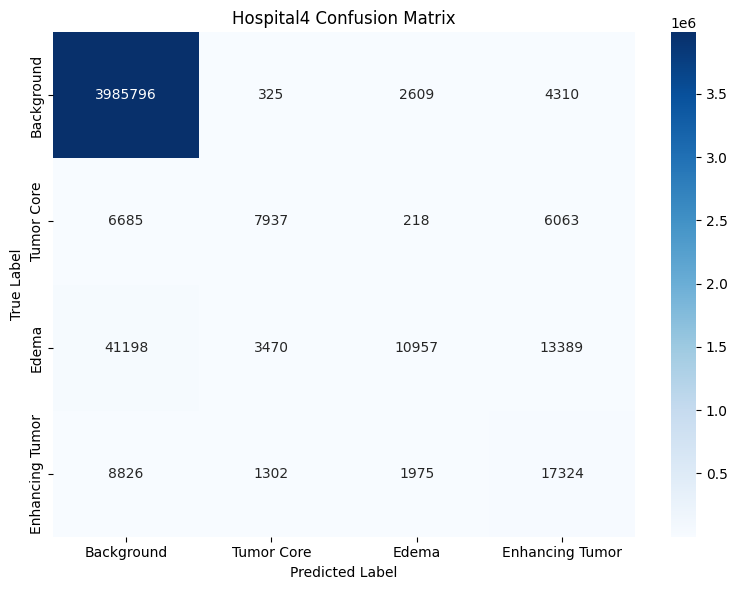

/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


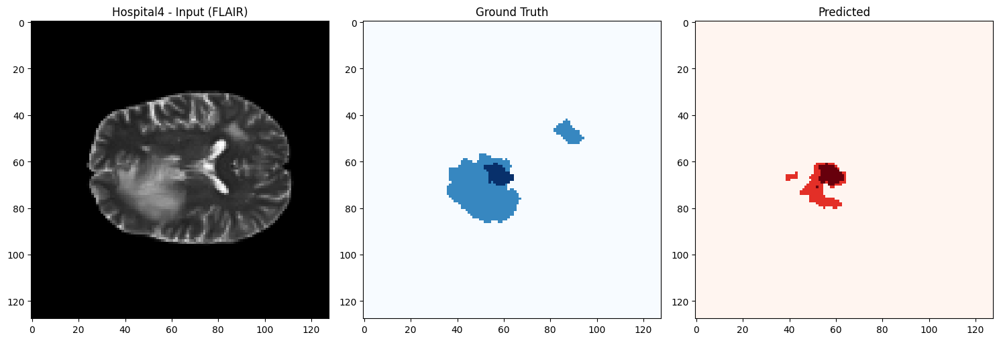


🔍 Evaluating Hospital5...


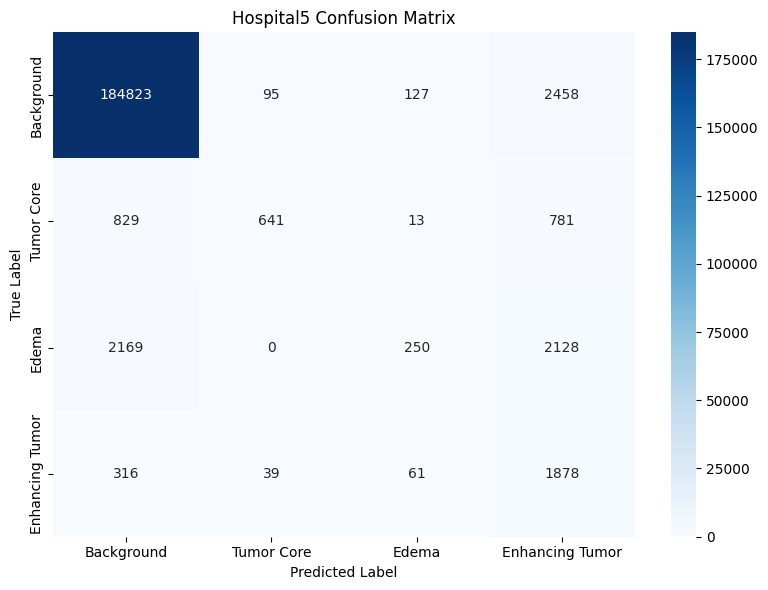

/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


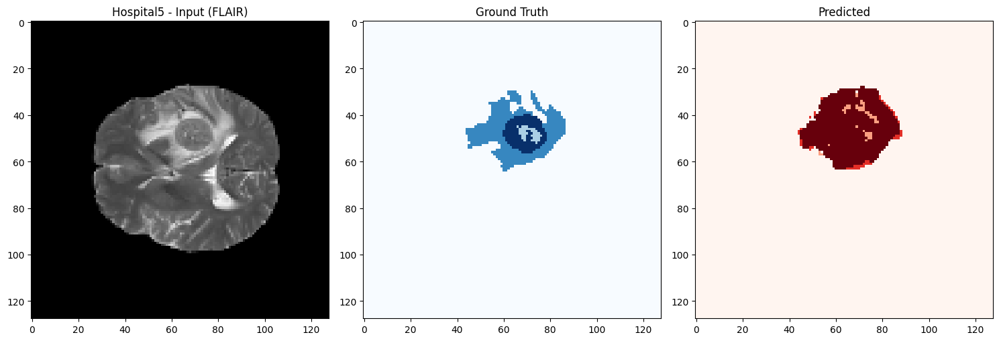


🔍 Evaluating Hospital6...


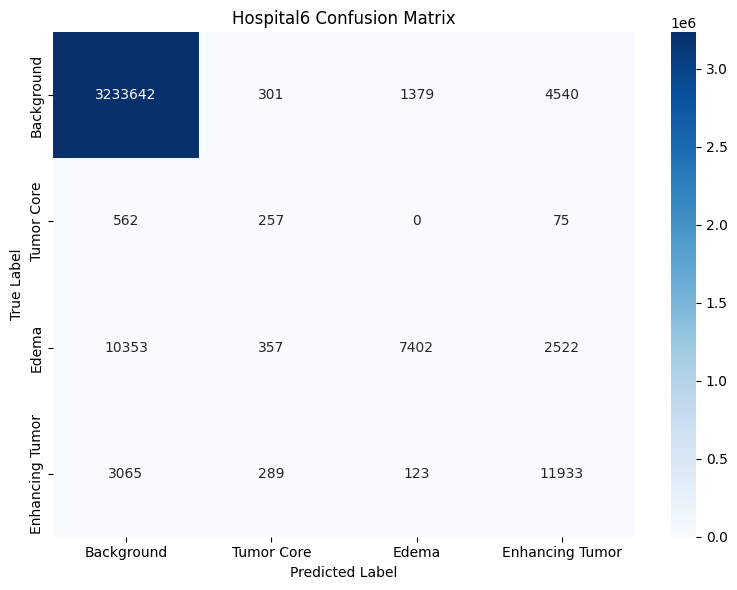

/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


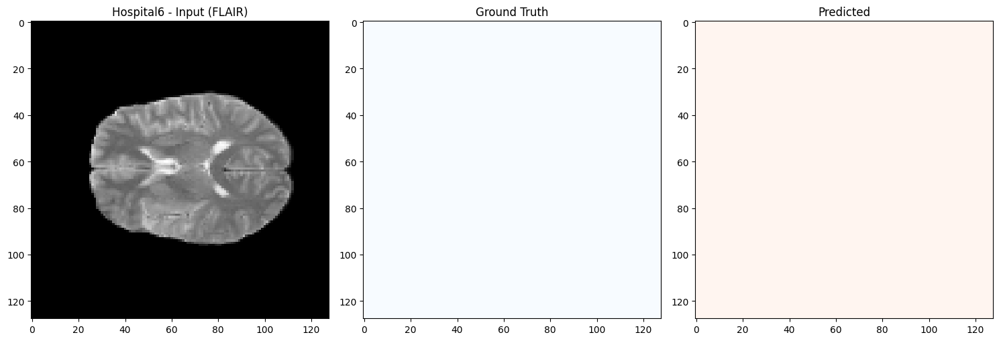


🔍 Evaluating Hospital7...


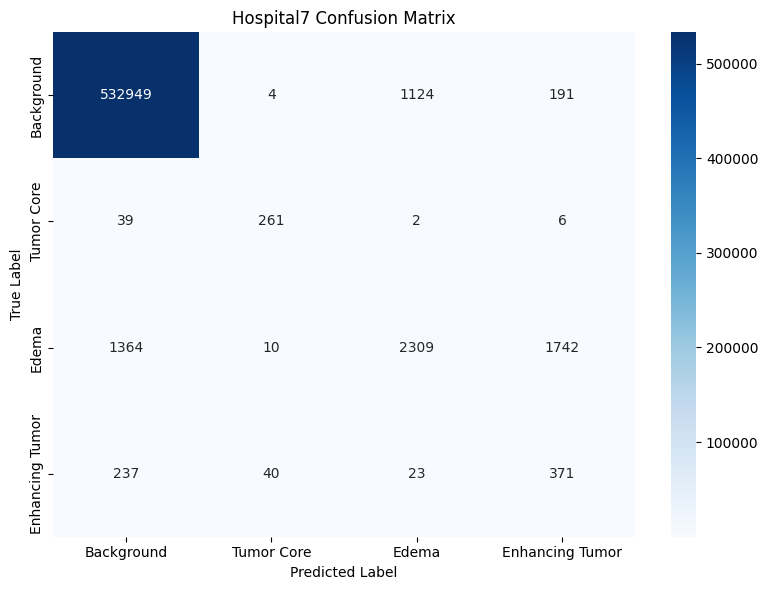

/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


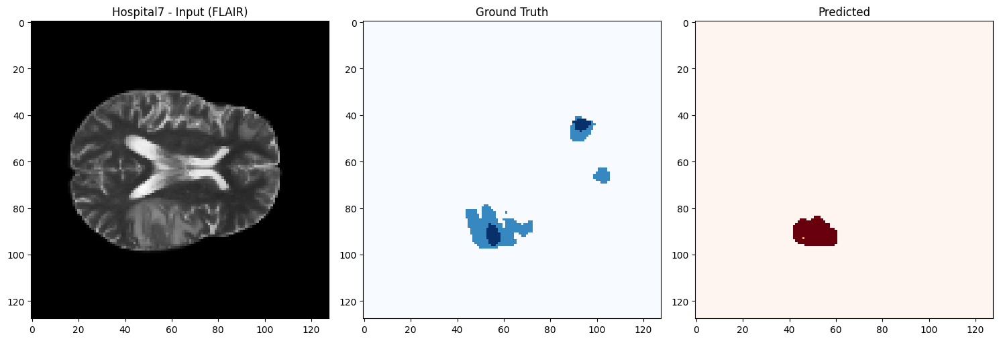


🔍 Evaluating Hospital8...


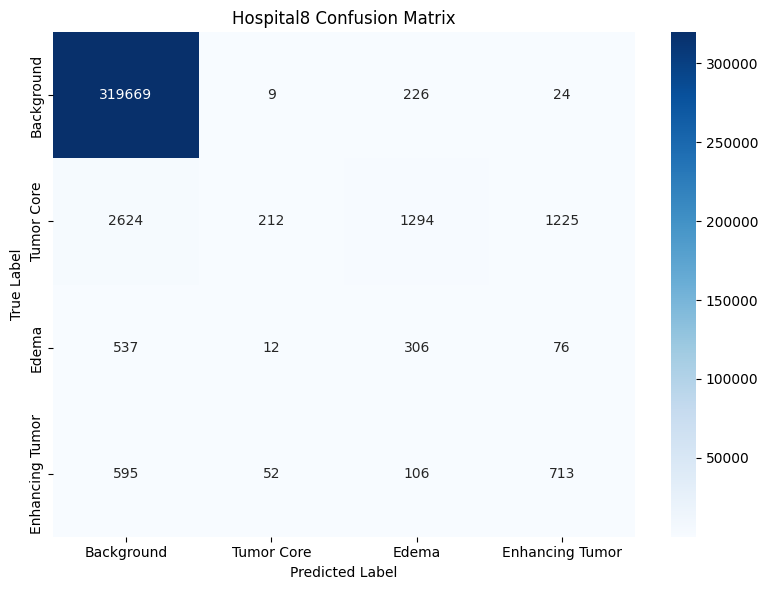

/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


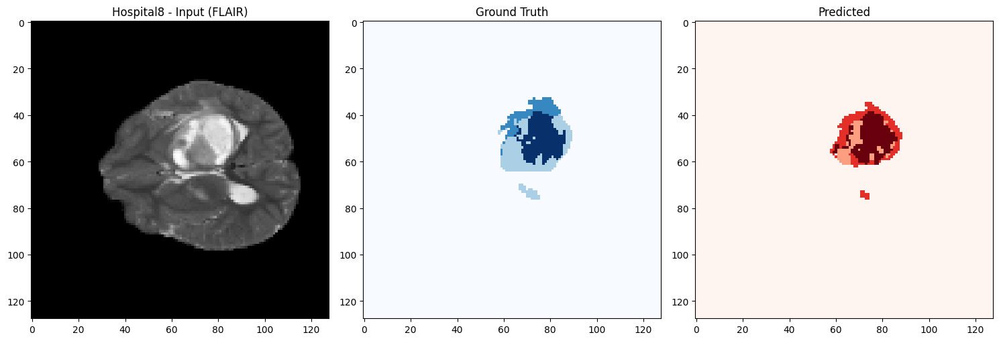


🔍 Evaluating Hospital9...


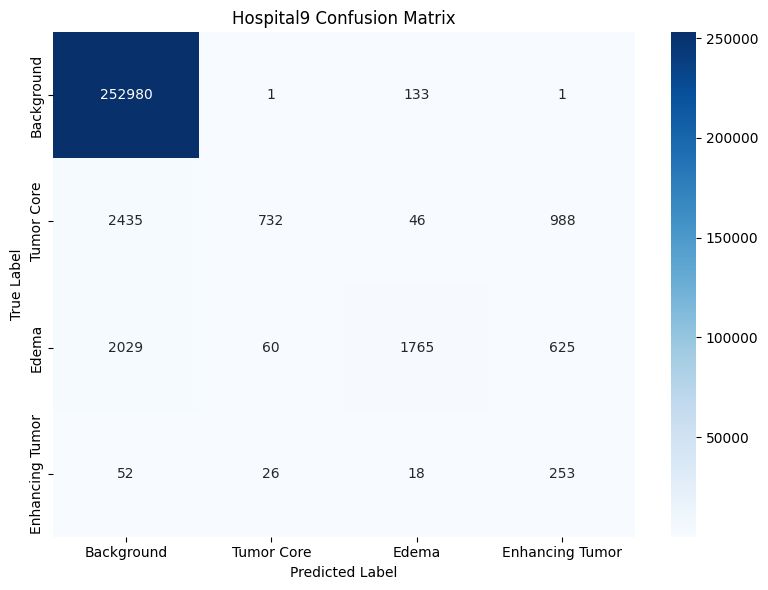

/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


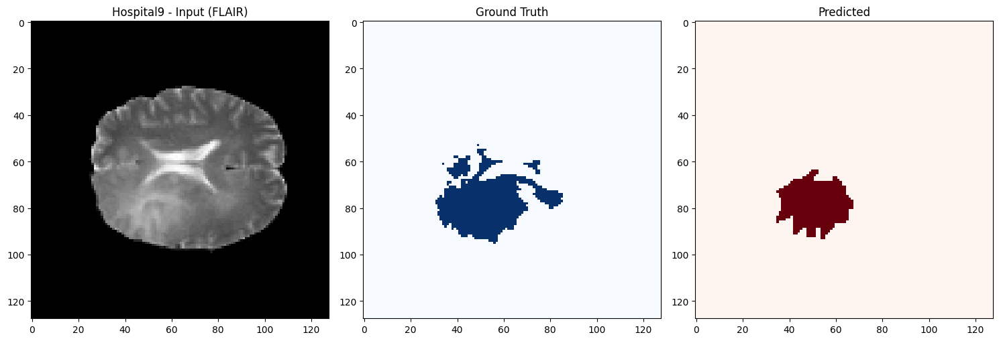

Saved results to TwinSegNet_Metrics_PerClient.csv


,Client,Background_Dice,Background_IoU,Tumor Core_Dice,Tumor Core_IoU,Edema_Dice,Edema_IoU,Enhancing Tumor_Dice,Enhancing Tumor_IoU
0,Hospital1,0.992557,0.985224,0.562728,0.391525,0.352933,0.214280,0.563726,0.392492
1,Hospital2,0.991137,0.982431,0.000000,0.000000,0.075410,0.039182,0.478378,0.314387
2,Hospital3,0.991400,0.982947,0.335728,0.201726,0.285948,0.166826,0.463055,0.301282
3,Hospital4,0.992041,0.984208,0.467749,0.305269,0.258502,0.148437,0.491370,0.325706
4,Hospital5,0.984043,0.968588,0.421849,0.267306,0.100040,0.052654,0.393752,0.245138
5,Hospital6,0.996886,0.993792,0.244995,0.139598,0.501185,0.334387,0.692169,0.529250
6,Hospital7,0.997232,0.994479,0.837881,0.720994,0.519869,0.351232,0.248910,0.142146
7,Hospital8,0.993759,0.987596,0.075177,0.039057,0.213762,0.119671,0.406963,0.255464
8,Hospital9,0.990891,0.981947,0.291633,0.170709,0.548052,0.377459,0.228339,0.128884


In [18]:
def evaluate_all_clients(global_model, hospital_loaders, client_list, class_names, device="cuda:1", num_classes=4):
    results = []

    for client in client_list:
        print(f"\n🔍 Evaluating {client}...")
        loader = hospital_loaders[client]["val"]
        global_model.to(device)
        metrics = predict_and_evaluate(global_model, loader, device=device, num_classes=num_classes)

        row = {"Client": client}
        for i, cls in enumerate(class_names):
            row[f"{cls}_Dice"] = metrics["dice"][i]
            row[f"{cls}_IoU"] = metrics["iou"][i]

        results.append(row)

        plot_confusion_matrix(metrics["confusion_matrix"], class_names, normalize=False, title=f"{client} Confusion Matrix")
        predict_and_overlay(global_model, loader, client_name=client)

    results_df = pd.DataFrame(results)
    results_df.to_csv("TwinSegNet_Metrics_PerClient.csv", index=False)
    print("Saved results to TwinSegNet_Metrics_PerClient.csv")
    return results_df

# Run across all clients
client_list = list(hospital_loaders.keys())
metrics_df = evaluate_all_clients(global_model, hospital_loaders, client_list, class_names)
metrics_df


In [19]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
import numpy as np
import torch.nn.functional as F

def plot_roc_curve(model, loader, class_names, device="cuda:1"):
    model.eval()
    y_true = []
    y_scores = []

    with torch.no_grad():
        for batch in loader:
            if len(batch) == 3:
                X, Y, _ = batch
            else:
                X, Y = batch
            X, Y = X.to(device), Y.to(device)

            # Model prediction: shape [B, C, D, H, W]
            Y_pred = model(X)

            # Softmax over classes
            probs = F.softmax(Y_pred, dim=1)  # [B, C, D, H, W]

            # Flatten predictions and labels
            probs = probs.permute(0, 2, 3, 4, 1).reshape(-1, probs.shape[1])  # [N, C]
            Y_flat = Y.view(-1)

            # One-hot encode ground truth
            y_true_1hot = F.one_hot(Y_flat, num_classes=probs.shape[1]).cpu().numpy()
            y_true.append(y_true_1hot)
            y_scores.append(probs.cpu().numpy())

    # Concatenate all batches
    y_true = np.concatenate(y_true, axis=0)
    y_scores = np.concatenate(y_scores, axis=0)

    # Plotting ROC curves
    plt.figure(figsize=(10, 8))
    for i, class_name in enumerate(class_names):
        fpr, tpr, _ = roc_curve(y_true[:, i], y_scores[:, i])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, lw=2, label=f'{class_name} (AUC = {roc_auc:.2f})')

    plt.plot([0, 1], [0, 1], 'k--', lw=1)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curve for Each Class")
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


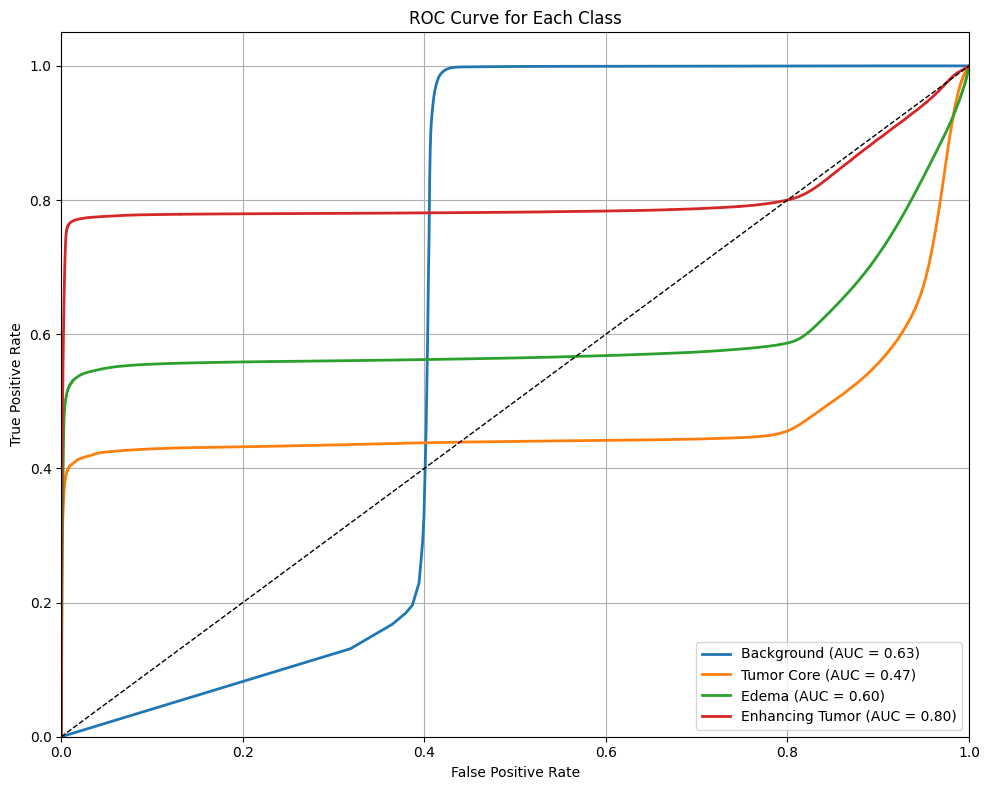

In [20]:
plot_roc_curve(global_model, hospital_loaders["Hospital3"]["val"], class_names)


In [21]:
def plot_global_model_roc_per_client(global_model, hospital_loaders, client_list, class_names, device="cuda:1"):
    """
    Plot ROC curves per class for the global model evaluated on multiple client datasets.
    """
    def compute_roc_data(model, loader):
        model.eval()
        y_true, y_scores = [], []
        with torch.no_grad():
            for batch in loader:
                if len(batch) == 3:
                    X, Y, _ = batch
                else:
                    X, Y = batch
                X, Y = X.to(device), Y.to(device)

                Y_pred = model(X)
                probs = F.softmax(Y_pred, dim=1)  # [B, C, D, H, W]
                probs = probs.permute(0, 2, 3, 4, 1).reshape(-1, probs.shape[1])  # [N, C]
                Y_flat = Y.view(-1)
                y_true_1hot = F.one_hot(Y_flat, num_classes=probs.shape[1]).cpu().numpy()
                y_true.append(y_true_1hot)
                y_scores.append(probs.cpu().numpy())

        return np.concatenate(y_true, axis=0), np.concatenate(y_scores, axis=0)

    plt.figure(figsize=(12, 8))
    colors = ['blue', 'green', 'red', 'orange', 'purple', 'cyan', 'brown', 'olive']

    for client_idx, client in enumerate(client_list):
        loader = hospital_loaders[client]["val"]
        y_true, y_scores = compute_roc_data(global_model.to(device), loader)

        for class_idx, class_name in enumerate(class_names):
            fpr, tpr, _ = roc_curve(y_true[:, class_idx], y_scores[:, class_idx])
            roc_auc = auc(fpr, tpr)
            color = colors[client_idx % len(colors)]
            plt.plot(fpr, tpr, label=f"{client} - {class_name} (AUC={roc_auc:.2f})", color=color, linestyle=['-', '--', ':', '-.'][class_idx % 4])

    plt.plot([0, 1], [0, 1], 'k--', lw=1)
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curves per Class (Global Model on Each Client)")
    plt.legend(fontsize=8)
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [22]:
# client_list = list(hospital_loaders.keys())
# plot_global_model_roc_per_client(global_model, hospital_loaders, client_list, class_names)


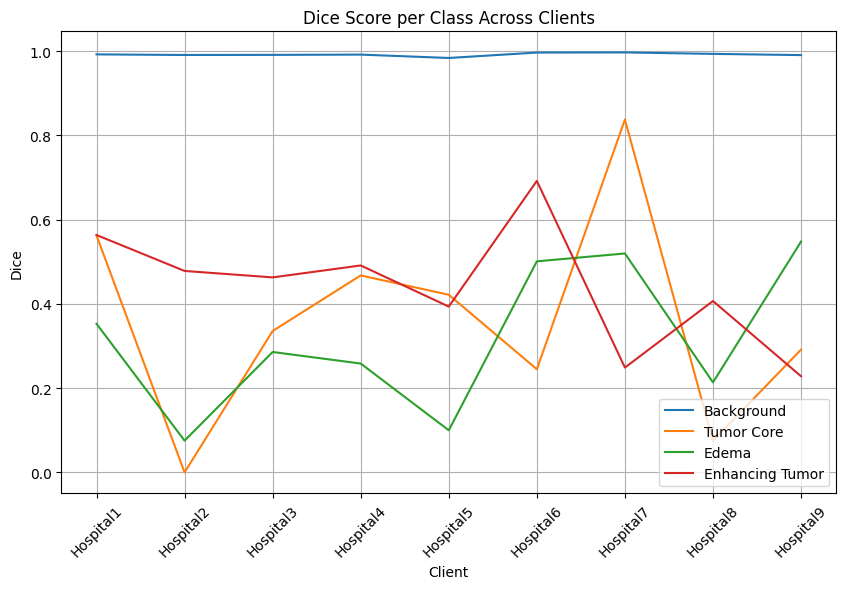

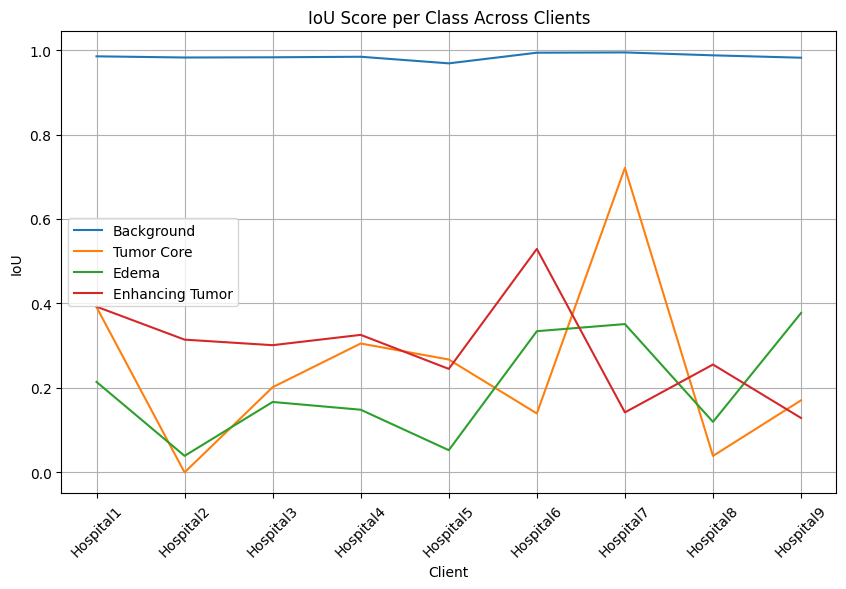

In [ ]:




import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load if not in memory
df = pd.read_csv("TwinSegNet_Metrics_PerClient.csv")

# Plot per-class Dice scores
def plot_metric(df, metric_type="Dice", save_path=None):
    class_names = ["Background", "Tumor Core", "Edema", "Enhancing Tumor"]
    plt.figure(figsize=(10, 6))
    
    for cls in class_names:
        col = f"{cls}_{metric_type}"
        sns.lineplot(data=df, x="Client", y=col, label=cls)
    
    plt.title(f"{metric_type} Score per Class Across Clients")
    plt.ylabel(metric_type)
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.legend()
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches="tight")
    plt.show()

plot_metric(df, "Dice", save_path="dice_comparison.png")
plot_metric(df, "IoU", save_path="iou_comparison.png")


In [ ]:
def fine_tune_digital_twin(global_model, client_name, hospital_loader, device="cuda:1"):
    model = copy.deepcopy(global_model).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-5)  # smaller LR for fine-tuning

    train_loader = hospital_loader[client_name]["train"]
    fine_tuned_state = train_one_client_verbose(model, train_loader, optimizer, epochs=1, client_name=f"DT-{client_name}", device=device)

    return model




In [ ]:
def evaluate_dt_vs_global(dt_models, global_model, hospital_loaders, class_names, device="cuda"):
    results = []
    for client in dt_models.keys():
        print(f"\n📊 Evaluating DT vs Global on {client}...")

        val_loader = hospital_loaders[client]["val"]

        # Evaluate global model
        global_metrics = predict_and_evaluate(global_model, val_loader, device=device)
        # Evaluate DT model
        dt_metrics = predict_and_evaluate(dt_models[client], val_loader, device=device)

        # Calculate average Dice/IoU (excluding background class)
        row = {
            "Client": client,
            "Global_Dice": np.mean(global_metrics["dice"][1:]),
            "DT_Dice": np.mean(dt_metrics["dice"][1:]),
            "Global_IoU": np.mean(global_metrics["iou"][1:]),
            "DT_IoU": np.mean(dt_metrics["iou"][1:])
        }

        results.append(row)

    # Save to CSV
    df = pd.DataFrame(results)
    df.to_csv("TwinSegNet_DT_vs_Global.csv", index=False)
    print("📄 Saved results to TwinSegNet_DT_vs_Global.csv")
    return df

# Call the function
dt_vs_global_df = evaluate_dt_vs_global(dt_models, global_model, hospital_loaders, class_names, device=device)


In [ ]:



import copy

dt_models = {}
for client in client_list:
    print(f"\n🛠️ Fine-tuning Digital Twin for {client}")
    dt_model = fine_tune_digital_twin(global_model, client, hospital_loaders, device=device)
    dt_models[client] = dt_model




🛠️ Fine-tuning Digital Twin for Hospital1

🔁 Training DT-Hospital1 | Epoch 1/1


/tmp/ipykernel_3531697/1997850118.py:46: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)
/tmp/ipykernel_3531697/1997850118.py:63: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


🩺 Case: BraTS-GLI-01452-000 | Batch 1/1000 | Loss: 0.2250 | Dice: 0.7018 | Acc: 0.9989 | IoU: 0.5743 | Prec: 0.7455 | Sen: 0.6919 | Spec: 0.9999
🩺 Case: BraTS-GLI-01229-000 | Batch 2/1000 | Loss: 0.2135 | Dice: 0.7209 | Acc: 0.9953 | IoU: 0.5665 | Prec: 0.6544 | Sen: 0.8346 | Spec: 0.9985
🩺 Case: BraTS-GLI-01385-000 | Batch 3/1000 | Loss: 0.1523 | Dice: 0.8033 | Acc: 0.9964 | IoU: 0.6803 | Prec: 0.8805 | Sen: 0.7569 | Spec: 0.9993
🩺 Case: BraTS-GLI-00650-000 | Batch 4/1000 | Loss: 0.2073 | Dice: 0.7258 | Acc: 0.9961 | IoU: 0.5947 | Prec: 0.7544 | Sen: 0.7960 | Spec: 0.9998
🩺 Case: BraTS-GLI-01135-000 | Batch 5/1000 | Loss: 0.1868 | Dice: 0.7571 | Acc: 0.9960 | IoU: 0.6174 | Prec: 0.8267 | Sen: 0.7660 | Spec: 0.9989
🩺 Case: BraTS-GLI-01187-000 | Batch 6/1000 | Loss: 0.4846 | Dice: 0.3527 | Acc: 0.9965 | IoU: 0.2191 | Prec: 0.4785 | Sen: 0.4730 | Spec: 0.9988
🩺 Case: BraTS-GLI-00445-000 | Batch 7/1000 | Loss: 0.1421 | Dice: 0.8163 | Acc: 0.9953 | IoU: 0.6921 | Prec: 0.8016 | Sen: 0.8400 

In [ ]:


def evaluate_dt_vs_global(dt_models, global_model, hospital_loaders, class_names, device="cuda"):
    results = []
    for client in client_list:
        print(f"\n📊 Evaluating DT vs Global on {client}...")

        val_loader = hospital_loaders[client]["val"]

        global_metrics = predict_and_evaluate(global_model, val_loader, device=device)
        dt_metrics = predict_and_evaluate(dt_models[client], val_loader, device=device)

        row = {
            "Client": client,
            "Global_Dice": np.mean(global_metrics["dice"][1:]),
            "DT_Dice": np.mean(dt_metrics["dice"][1:]),
            "Global_IoU": np.mean(global_metrics["iou"][1:]),
            "DT_IoU": np.mean(dt_metrics["iou"][1:]),
        }

        results.append(row)

    df = pd.DataFrame(results)
    df.to_csv("TwinSegNet_DT_vs_Global.csv", index=False)
    print("📄 Saved results to TwinSegNet_DT_vs_Global.csv")
    return df







📊 Evaluating DT vs Global on Hospital1...


/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)



📊 Evaluating DT vs Global on Hospital2...


/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)
/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-projec


📊 Evaluating DT vs Global on Hospital3...


/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)
/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-projec


📊 Evaluating DT vs Global on Hospital4...


/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)
/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-projec


📊 Evaluating DT vs Global on Hospital5...


/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)
/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-projec


📊 Evaluating DT vs Global on Hospital6...


/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)
/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-projec


📊 Evaluating DT vs Global on Hospital7...


/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)
/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-projec


📊 Evaluating DT vs Global on Hospital8...


/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)
/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-projec


📊 Evaluating DT vs Global on Hospital9...


/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-project/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)
/home/awakili/anaconda3/envs/DLEnv/lib/python3.9/site-packages/torchio/data/image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/TorchIO-projec

📄 Saved results to TwinSegNet_DT_vs_Global.csv


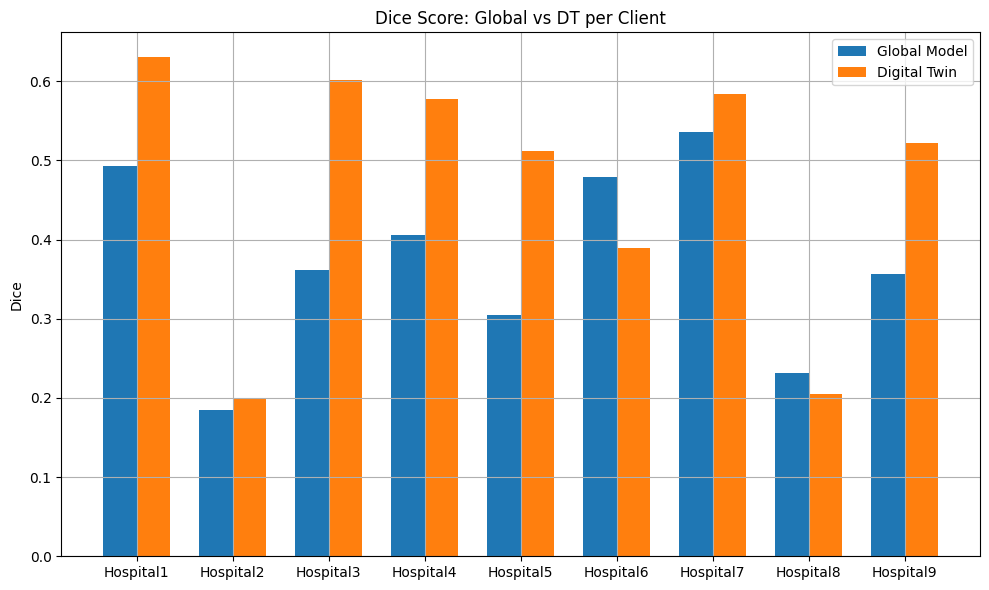

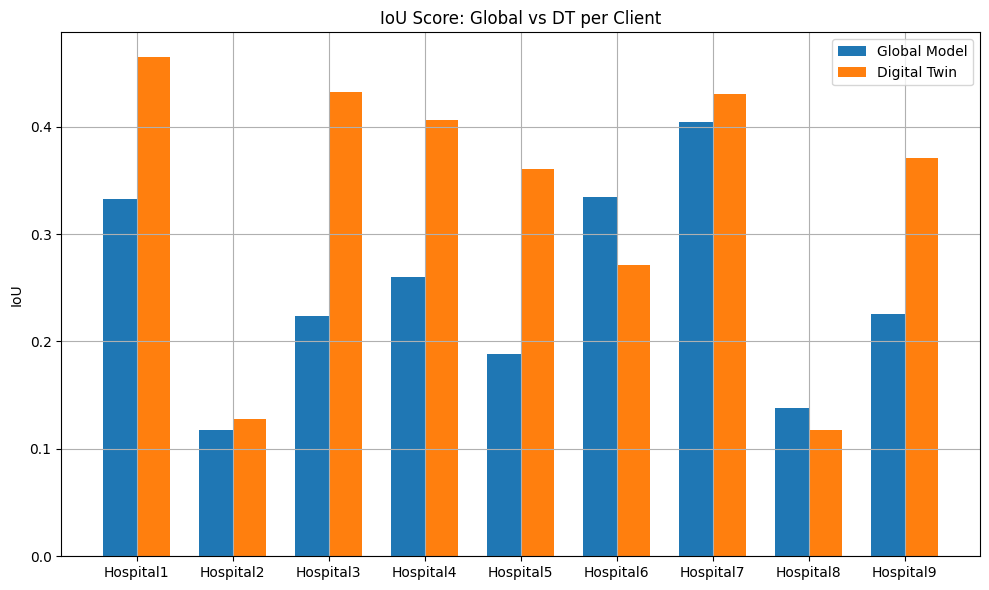

In [27]:
def plot_dt_vs_global(df, metric="Dice", save_path=None):
    x = np.arange(len(df))
    width = 0.35

    fig, ax = plt.subplots(figsize=(10, 6))
    ax.bar(x - width/2, df[f"Global_{metric}"], width, label="Global Model")
    ax.bar(x + width/2, df[f"DT_{metric}"], width, label="Digital Twin")

    ax.set_ylabel(metric)
    ax.set_title(f"{metric} Score: Global vs DT per Client")
    ax.set_xticks(x)
    ax.set_xticklabels(df["Client"])
    ax.legend()
    plt.grid(True)
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches="tight")
    plt.tight_layout()
    plt.show()

# Usage
dt_vs_global_df = evaluate_dt_vs_global(dt_models, global_model, hospital_loaders, class_names, device=device)
plot_dt_vs_global(dt_vs_global_df, metric="Dice", save_path="dt_vs_global_dice.png")
plot_dt_vs_global(dt_vs_global_df, metric="IoU", save_path="dt_vs_global_iou.png")


In [28]:


def evaluate_all_clients(global_model, hospital_loaders, client_list, class_names, device="cuda", num_classes=4, save_path="TumorVisNet_Metrics_PerClient.xlsx"):
    results = []

    for client in client_list:
        print(f"\n🔍 Evaluating {client}...")
        loader = hospital_loaders[client]["val"]
        metrics = predict_and_evaluate(global_model, loader, device=device, num_classes=num_classes)

        row = {"Client": client}
        for i, cls in enumerate(class_names):
            row[f"{cls}_Dice"] = metrics["dice"][i]
            row[f"{cls}_IoU"] = metrics["iou"][i]

        results.append(row)

    results_df = pd.DataFrame(results)
    results_df.to_excel(save_path, index=False)
    print(f"✅ Saved metrics to {save_path}")
    return results_df



In [ ]:
def plot_metric_from_excel(filepath, metric_type="Dice", save_path=None):
    df = pd.read_excel(filepath)
    class_names = ["Background", "Tumor Core", "Edema", "Enhancing Tumor"]

    plt.figure(figsize=(10, 6))
    for cls in class_names:
        col = f"{cls}_{metric_type}"
        sns.lineplot(data=df, x="Client", y=col, label=cls)

    plt.title(f"{metric_type} Score per Class Across Clients")
    plt.ylabel(metric_type)
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.legend()
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches="tight")
    plt.show()


In [30]:
def evaluate_dt_vs_global(dt_models, global_model, hospital_loaders, class_names, device="cuda", save_path="TwinSegNet_DT_vs_Global.xlsx"):
    results = []
    for client in hospital_loaders:
        print(f"\n📊 Evaluating DT vs Global on {client}...")
        val_loader = hospital_loaders[client]["val"]
        global_metrics = predict_and_evaluate(global_model, val_loader, device=device)
        dt_metrics = predict_and_evaluate(dt_models[client], val_loader, device=device)

        row = {
            "Client": client,
            "Global_Dice": np.mean(global_metrics["dice"][1:]),
            "DT_Dice": np.mean(dt_metrics["dice"][1:]),
            "Global_IoU": np.mean(global_metrics["iou"][1:]),
            "DT_IoU": np.mean(dt_metrics["iou"][1:]),
        }
        results.append(row)

    df = pd.DataFrame(results)
    df.to_excel(save_path, index=False)
    print(f"📄 Saved results to {save_path}")
    return df


In [31]:
def plot_dt_vs_global_from_excel(filepath, metric="Dice", save_path=None):
    df = pd.read_excel(filepath)
    x = np.arange(len(df))
    width = 0.35

    fig, ax = plt.subplots(figsize=(10, 6))
    ax.bar(x - width/2, df[f"Global_{metric}"], width, label="Global Model")
    ax.bar(x + width/2, df[f"DT_{metric}"], width, label="Digital Twin")

    ax.set_ylabel(metric)
    ax.set_title(f"{metric} Score: Global vs DT per Client")
    ax.set_xticks(x)
    ax.set_xticklabels(df["Client"])
    ax.legend()
    plt.grid(True)
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches="tight")
    plt.tight_layout()
    plt.show()


In [32]:
def evaluate_all_clients(global_model, hospital_loaders, client_list, class_names, device="cuda", num_classes=4, save_path="TumorVisNet_Metrics_PerClient.xlsx"):
    results = []

    for client in client_list:
        print(f"\n🔍 Evaluating {client}...")
        loader = hospital_loaders[client]["val"]
        metrics = predict_and_evaluate(global_model, loader, device=device, num_classes=num_classes)

        row = {"Client": client}
        for i, cls in enumerate(class_names):
            row[f"{cls}_Dice"] = metrics["dice"][i]
            row[f"{cls}_IoU"] = metrics["iou"][i]

        results.append(row)

    df = pd.DataFrame(results)
    df.to_excel(save_path, index=False)
    print(f"✅ Saved metrics to {save_path}")
    return df


In [43]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def plot_metric_from_excel(filepath, metric_type="Dice", save_path="metric_plot.png"):
    df = pd.read_excel(filepath)
    class_names = ["Background", "Tumor Core", "Edema", "Enhancing Tumor"]

    plt.figure(figsize=(10, 6))
    for cls in class_names:
        col = f"{cls}_{metric_type}"
        sns.lineplot(data=df, x="Client", y=col, label=cls)

    plt.title(f"{metric_type} Score per Class Across Clients")
    plt.ylabel(metric_type)
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.savefig(save_path, dpi=300)
    plt.show()
    plt.close()
    print(f"📊 Saved plot to {save_path}")


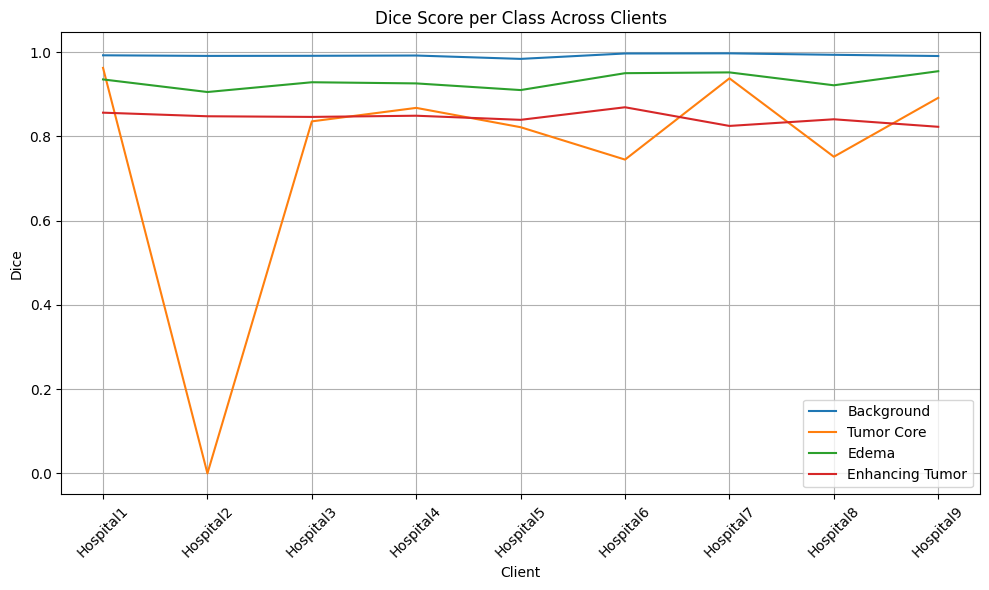

📊 Saved plot to dice_plot.png


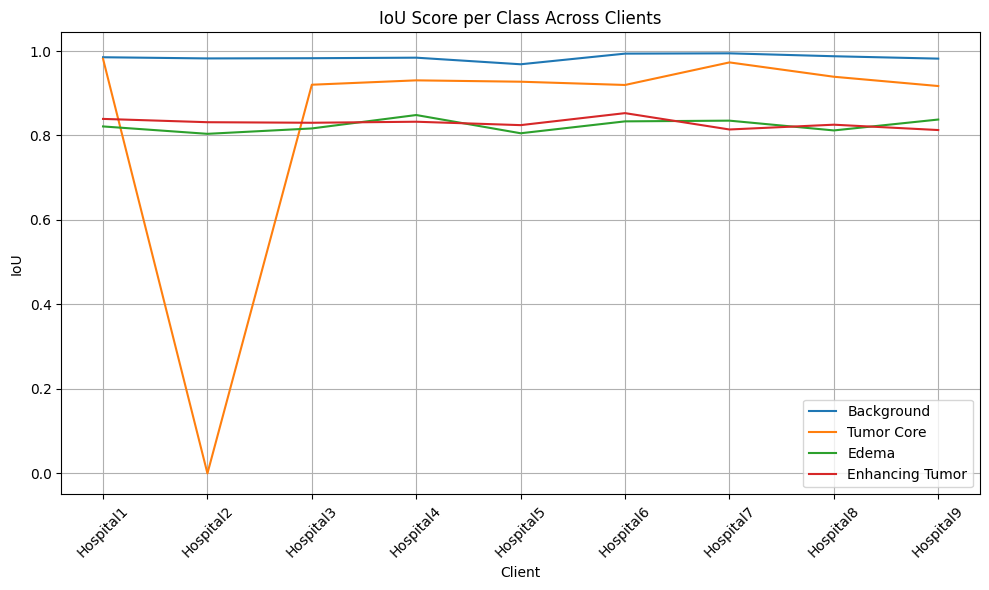

📊 Saved plot to iou_plot.png


In [44]:
client_list = list(hospital_loaders.keys())
class_names = ["Background", "Tumor Core", "Edema", "Enhancing Tumor"]

# 1. Evaluate & Save
#evaluate_all_clients(global_model, hospital_loaders, client_list, class_names)

# 2. Plot from saved Excel
plot_metric_from_excel("TumorVisNet_Metrics_PerClient.xlsx", metric_type="Dice", save_path="dice_plot.png")
plot_metric_from_excel("TumorVisNet_Metrics_PerClient.xlsx", metric_type="IoU", save_path="iou_plot.png")


In [40]:
import pandas as pd
import numpy as np

def evaluate_dt_vs_global(dt_models, global_model, hospital_loaders, class_names, device="cuda", save_path="TwinSegNet_DT_vs_Global.xlsx"):
    results = []

    for client in hospital_loaders:
        print(f"\n📊 Evaluating DT vs Global on {client}...")
        val_loader = hospital_loaders[client]["val"]

        global_metrics = predict_and_evaluate(global_model, val_loader, device=device)
        dt_metrics = predict_and_evaluate(dt_models[client], val_loader, device=device)

        row = {
            "Client": client,
            "Global_Dice": np.mean(global_metrics["dice"][1:]),  # exclude background
            "DT_Dice": np.mean(dt_metrics["dice"][1:]),
            "Global_IoU": np.mean(global_metrics["iou"][1:]),
            "DT_IoU": np.mean(dt_metrics["iou"][1:]),
        }

        results.append(row)

    df = pd.DataFrame(results)
    df.to_excel(save_path, index=False)
    print(f"✅ Saved DT vs Global results to {save_path}")
    return df


In [46]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

def plot_dt_vs_global_from_excel(filepath, metric="Dice", save_path="dt_vs_global_plot.png"):
    df = pd.read_excel(filepath)
    x = np.arange(len(df))
    width = 0.35

    fig, ax = plt.subplots(figsize=(10, 6))
    ax.bar(x - width/2, df[f"Global_{metric}"], width, label="Global Model")
    ax.bar(x + width/2, df[f"DT_{metric}"], width, label="Digital Twin")

    ax.set_ylabel(metric)
    ax.set_title(f"{metric} Score: Global vs DT per Client")
    ax.set_xticks(x)
    ax.set_xticklabels(df["Client"])
    ax.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(save_path, dpi=300)
    plt.show()
    plt.close()
    print(f"📊 Saved DT vs Global {metric} plot to {save_path}")


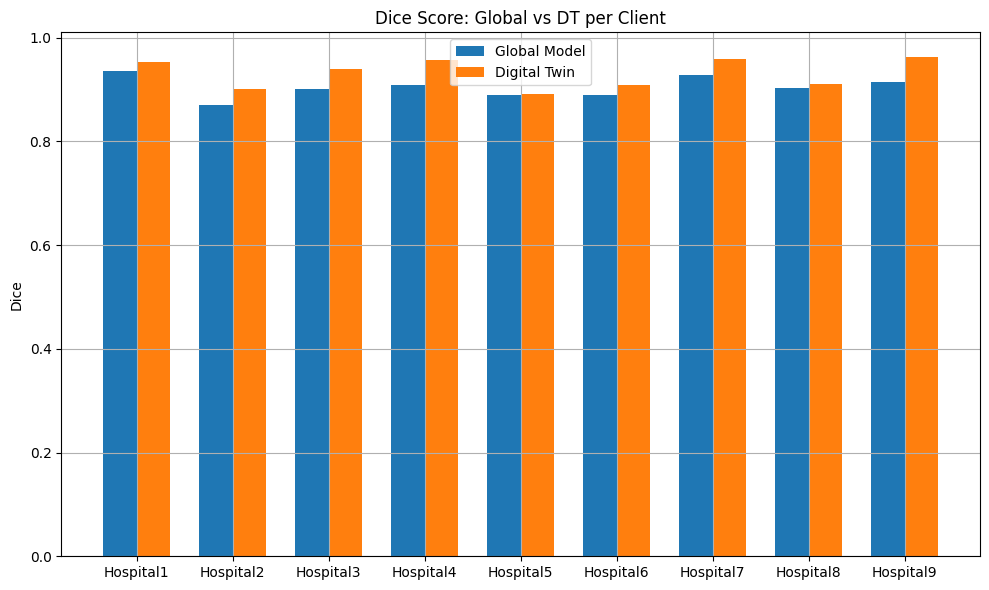

📊 Saved DT vs Global Dice plot to dt_vs_global_dice.png


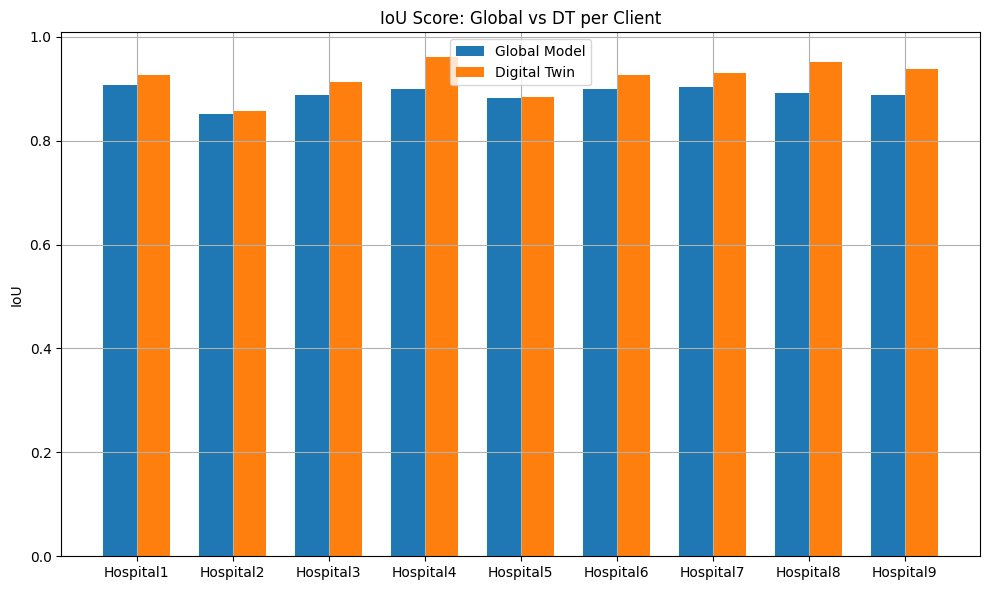

📊 Saved DT vs Global IoU plot to dt_vs_global_iou.png


In [49]:
# 1. Evaluate & Save to Excel
#dt_vs_global_df = evaluate_dt_vs_global(dt_models, global_model, hospital_loaders, class_names)

# 2. Plot from Excel
plot_dt_vs_global_from_excel("TwinSegNet_DT_vs_Global.xlsx", metric="Dice", save_path="dt_vs_global_dice.png")
plot_dt_vs_global_from_excel("TwinSegNet_DT_vs_Global.xlsx", metric="IoU", save_path="dt_vs_global_iou.png")
